In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from datetime import timedelta

In [4]:
slurm = pd.read_csv("/mnt/research/CMSE495-SS24-ICER/slurm_usage/DID_FINAL_SLURM_OCT_2023.csv",delimiter="|", nrows=100000)


In [5]:
slurm.columns

Index(['Unnamed: 0', 'JobID', 'User', 'Group', 'Submit', 'Start', 'End',
       'Elapsed', 'State', 'Account', 'AssocID', 'Partition', 'Timelimit',
       'UserCPU', 'SystemCPU', 'TotalCPU', 'CPUTime', 'CPUTimeRAW', 'ReqCPUS',
       'AllocCPUS', 'ReqMem', 'MaxRSS', 'ReqNodes', 'NNodes', 'NodeList',
       'ReqTRES', 'AllocTRES'],
      dtype='object')

In [7]:
slurm.head()

,Unnamed: 0,JobID,User,Group,Submit,Start,End,Elapsed,State,Account,...,CPUTimeRAW,ReqCPUS,AllocCPUS,ReqMem,MaxRSS,ReqNodes,NNodes,NodeList,ReqTRES,AllocTRES
0,336748,92134676,user_272,group_154,2023-10-02T19:49:11,2023-10-02T19:51:56,2023-10-02T23:20:44,03:28:48,COMPLETED,account_016,...,12528,1,1,200G,2281632K,1,1,acm-025,"billing=31129,cpu=1,mem=200G,node=1","billing=31129,cpu=1,mem=200G,node=1"
1,336736,92134676,user_272,group_154,2023-10-02T19:49:11,2023-10-02T19:51:51,2023-10-02T23:34:24,03:42:33,COMPLETED,account_016,...,13353,1,1,200G,2323692K,1,1,amr-204,"billing=31129,cpu=1,mem=200G,node=1","billing=31129,cpu=1,mem=200G,node=1"
2,336733,92134676,user_272,group_154,2023-10-02T19:49:11,2023-10-02T19:49:16,2023-10-02T23:38:41,03:49:25,COMPLETED,account_016,...,13765,1,1,200G,2279580K,1,1,amr-241,"billing=31129,cpu=1,mem=200G,node=1","billing=31129,cpu=1,mem=200G,node=1"
3,336730,92134676,user_272,group_154,2023-10-02T19:49:11,2023-10-02T19:49:16,2023-10-02T23:40:47,03:51:31,COMPLETED,account_016,...,13891,1,1,200G,2280680K,1,1,amr-241,"billing=31129,cpu=1,mem=200G,node=1","billing=31129,cpu=1,mem=200G,node=1"
4,336727,92134676,user_272,group_154,2023-10-02T19:49:11,2023-10-02T19:49:16,2023-10-02T23:47:02,03:57:46,COMPLETED,account_016,...,14266,1,1,200G,2357408K,1,1,amr-241,"billing=31129,cpu=1,mem=200G,node=1","billing=31129,cpu=1,mem=200G,node=1"


# Preprocessing Data

In [6]:
# convert Submit and Start to datetime, and filter rows with 'Unknown' start

# Filter out rows where 'State' is "Cancelled" or Unknown
slurm = slurm[slurm['State'] != 'Cancelled']
slurm = slurm[slurm['Start']!= 'Unknown']

slurm['Submit'] = pd.to_datetime(slurm['Submit'])
slurm['Start'] = pd.to_datetime(slurm['Start'])

slurm.head(5)

,JobID,User,Group,Submit,Start,End,Elapsed,State,Account,AssocID,...,CPUTimeRAW,ReqCPUS,AllocCPUS,ReqMem,MaxRSS,ReqNodes,NNodes,NodeList,ReqTRES,AllocTRES
4,59062820,user_188,group_046,2023-05-08 09:58:20,2024-01-01 00:58:57,2024-01-01T00:59:06,00:00:09,COMPLETED,account_017,assocID_676,...,360,40,40,8G,NaN,1,1,skl-029,"billing=1245,cpu=40,mem=8G,node=1","billing=1245,cpu=40,mem=8G,node=1"
5,59062828,user_188,group_046,2023-05-08 09:58:20,2024-01-01 01:00:49,2024-01-01T01:00:55,00:00:06,COMPLETED,account_017,assocID_676,...,240,40,40,8G,NaN,1,1,skl-029,"billing=1245,cpu=40,mem=8G,node=1","billing=1245,cpu=40,mem=8G,node=1"
6,59062836,user_188,group_046,2023-05-08 09:58:20,2024-01-01 01:00:49,2024-01-01T01:00:55,00:00:06,COMPLETED,account_017,assocID_676,...,240,40,40,8G,NaN,1,1,skl-030,"billing=1245,cpu=40,mem=8G,node=1","billing=1245,cpu=40,mem=8G,node=1"
7,59062844,user_188,group_046,2023-05-08 09:58:21,2024-01-01 00:58:57,2024-01-01T00:59:06,00:00:09,COMPLETED,account_017,assocID_676,...,360,40,40,8G,NaN,1,1,amr-207,"billing=1245,cpu=40,mem=8G,node=1","billing=1245,cpu=40,mem=8G,node=1"
8,59062852,user_188,group_046,2023-05-08 09:58:21,2024-01-01 00:58:57,2024-01-01T00:59:06,00:00:09,COMPLETED,account_017,assocID_676,...,360,40,40,8G,NaN,1,1,amr-207,"billing=1245,cpu=40,mem=8G,node=1","billing=1245,cpu=40,mem=8G,node=1"


In [7]:
# remove user_258 and clean jobs data
def AggSLURMDat(dat):
    '''
    Aggregates all submitted jobs together, removing all batch/extern 
    jobs and including said information into a single job. Excludes
    jobs that do not have a clear '.batch' and '.extern' files

    args:

        dat - the slurm dataset 
    
    returns:

        out_df - the aggregated version of the slurm dataset
    '''
    
    job_list = dat["JobID"].value_counts().index

    out_df = pd.DataFrame(columns=dat.keys())

    for job in job_list:

        jdat = dat[dat["JobID"] == job]

        cpu_time_list = jdat["CPUTimeRAW"].value_counts()
        cpu_time_list = cpu_time_list[cpu_time_list == 2].index

        for cpu_time in cpu_time_list:

            ajob = jdat[jdat["CPUTimeRAW"] == cpu_time]

            batch_job = ajob[ajob["User"] == "user_258"]

            ag_job = ajob[ajob["User"] != "user_258"]

            if len(ag_job["User"]) == 0:
#                 print("Weird Job",ajob["JobID"])
#                 print("No aggregate job")
                continue
            
            if len(ag_job["User"]) == 2:
#                 print("Weird Job",ajob["JobID"])
#                 print("2 copies of aggregate job")
                continue

            assert len(ag_job["User"]) == 1, "New edge case discovered!"

            ag_job.loc[ag_job.index[0],"MaxRSS"] = batch_job["MaxRSS"].values[0]

            out_df = pd.concat([out_df,ag_job])

    return out_df

In [8]:
# test
slurm_cleaned = AggSLURMDat(slurm)
slurm_cleaned

,JobID,User,Group,Submit,Start,End,Elapsed,State,Account,AssocID,...,CPUTimeRAW,ReqCPUS,AllocCPUS,ReqMem,MaxRSS,ReqNodes,NNodes,NodeList,ReqTRES,AllocTRES
75766,91806820,user_316,group_009,2023-10-01 10:08:04,2023-10-01 10:08:30,2023-10-01T10:11:08,00:02:38,COMPLETED,account_017,assocID_554,...,158,1,1,10G,348380K,1,1,lac-351,"billing=1556,cpu=1,mem=10G,node=1","billing=1556,cpu=1,mem=10G,node=1"
75880,91806820,user_316,group_009,2023-10-01 10:08:04,2023-10-01 10:08:30,2023-10-01T10:09:18,00:00:48,FAILED,account_017,assocID_554,...,48,1,1,10G,8156K,1,1,lac-367,"billing=1556,cpu=1,mem=10G,node=1","billing=1556,cpu=1,mem=10G,node=1"
77026,91806820,user_316,group_009,2023-10-01 10:08:04,2023-10-01 10:08:31,2023-10-01T10:10:33,00:02:02,FAILED,account_017,assocID_554,...,122,1,1,10G,344968K,1,1,lac-295,"billing=1556,cpu=1,mem=10G,node=1","billing=1556,cpu=1,mem=10G,node=1"
77281,91806820,user_316,group_009,2023-10-01 10:08:04,2023-10-01 10:08:31,2023-10-01T10:11:31,00:03:00,COMPLETED,account_017,assocID_554,...,180,1,1,10G,489700K,1,1,lac-299,"billing=1556,cpu=1,mem=10G,node=1","billing=1556,cpu=1,mem=10G,node=1"
76963,91806820,user_316,group_009,2023-10-01 10:08:04,2023-10-01 10:08:31,2023-10-01T10:09:36,00:01:05,FAILED,account_017,assocID_554,...,65,1,1,10G,270400K,1,1,lac-294,"billing=1556,cpu=1,mem=10G,node=1","billing=1556,cpu=1,mem=10G,node=1"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29569,91740004,user_128,group_062,2023-10-01 00:37:59,2023-10-01 00:39:32,2023-10-01T00:46:35,00:07:03,COMPLETED,account_030,assocID_561,...,1692,4,4,8G,531208K,1,1,amr-162,"billing=1245,cpu=4,mem=8G,node=1","billing=1245,cpu=4,mem=8G,node=1"
29572,91740008,user_128,group_062,2023-10-01 00:37:59,2023-10-01 00:39:38,2023-10-01T00:46:42,00:07:04,COMPLETED,account_030,assocID_561,...,1696,4,4,8G,528908K,1,1,amr-162,"billing=1245,cpu=4,mem=8G,node=1","billing=1245,cpu=4,mem=8G,node=1"
29575,91740012,user_128,group_062,2023-10-01 00:38:00,2023-10-01 00:39:43,2023-10-01T00:45:59,00:06:16,COMPLETED,account_030,assocID_561,...,1504,4,4,8G,490392K,1,1,amr-162,"billing=1245,cpu=4,mem=8G,node=1","billing=1245,cpu=4,mem=8G,node=1"
29530,91739952,user_128,group_062,2023-10-01 00:37:49,2023-10-01 00:38:49,2023-10-01T00:50:17,00:11:28,COMPLETED,account_030,assocID_561,...,2752,4,4,8G,747872K,1,1,amr-162,"billing=1245,cpu=4,mem=8G,node=1","billing=1245,cpu=4,mem=8G,node=1"


 # Feature Engineering of Cleaned SLURM 
 - After Mapping user258 to find underutilization in Memery
 
 1. Convert memory units to all be in MB columns:ReqMem, MaxRSS
 2. Convert Timelimit and Elapsed columns from object to datetime

In [9]:
slurm_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 15689 entries, 75766 to 29500
Data columns (total 26 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   JobID       15689 non-null  object        
 1   User        15689 non-null  object        
 2   Group       15689 non-null  object        
 3   Submit      15689 non-null  datetime64[ns]
 4   Start       15689 non-null  datetime64[ns]
 5   End         15689 non-null  object        
 6   Elapsed     15689 non-null  object        
 7   State       15689 non-null  object        
 8   Account     15689 non-null  object        
 9   AssocID     15689 non-null  object        
 10  Partition   15689 non-null  object        
 11  Timelimit   15689 non-null  object        
 12  UserCPU     15689 non-null  object        
 13  SystemCPU   15689 non-null  object        
 14  TotalCPU    15689 non-null  object        
 15  CPUTime     15689 non-null  object        
 16  CPUTimeRAW  15689 

In [8]:
# remove na rows in MaxRSS after cleaning data
# slurm_cleaned= slurm_cleaned.dropna(subset=['MaxRSS'])
# slurm_cleaned

slurm_cleaned = pd.read_csv("/mnt/scratch/tairaeli/cmse_dat/clean_slurm.csv")
slurm_cleaned = slurm_cleaned.drop(["Unnamed: 0"], axis = 1)
slurm_cleaned.head()

Index(['JobID', 'User', 'Group', 'Submit', 'Start', 'End', 'Elapsed', 'State',
       'Account', 'AssocID', 'Partition', 'Timelimit', 'UserCPU', 'SystemCPU',
       'TotalCPU', 'CPUTime', 'CPUTimeRAW', 'ReqCPUS', 'AllocCPUS', 'ReqMem',
       'MaxRSS', 'ReqNodes', 'NNodes', 'NodeList', 'ReqTRES', 'AllocTRES'],
      dtype='object')

/mnt/home/tairaeli/anaconda3/envs/data_sc/lib/python3.12/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/mnt/home/tairaeli/anaconda3/envs/data_sc/lib/python3.12/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


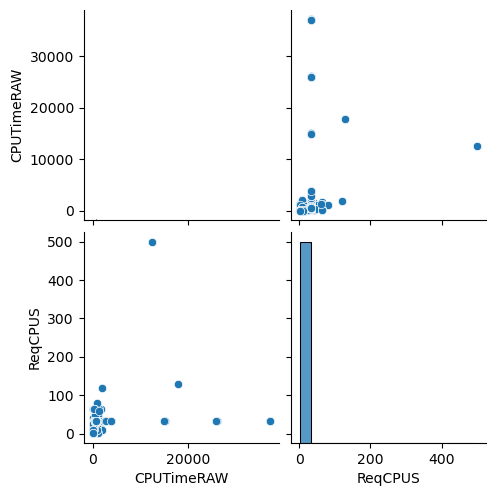

In [9]:
# looking at the na values
ids = slurm_cleaned["MaxRSS"][slurm_cleaned["MaxRSS"].isna()].index

any_completed = slurm_cleaned.iloc[ids]["State"] == "COMPLETED"

# some weird results here. Maybe jobs that "completed" as in the script ran then immediately errored out, but still counted as a completion?
slurm_instafail = slurm_cleaned.iloc[ids]

sns.pairplot(slurm_instafail[["CPUTimeRAW","ReqCPUS","Timelimit"]])

In [13]:
# removing null values
# slurm_cleaned.info()

slurm_cleaned = slurm_cleaned.dropna()

print(set(slurm_cleaned.ReqMem))
print(set(slurm_cleaned.MaxRSS))

{'187500M', '240G', '16000M', '27000M', '5G', '10000M', '75G', '280G', '20M', '10G', '64G', '480G', '48G', '1250G', '1750G', '2000G', '20G', '500G', '320G', '1T', '2.50G', '400G', '25G', '3T', '160G', '8000M', '1280G', '30G', '72G', '640G', '384G', '70G', '512M', '40000M', '164G', '2016G', '96000M', '285G', '4G', '128G', '37500M', '96G', '30000M', '36G', '62.50G', '1100G', '200G', '512G', '1500G', '2T', '24G', '750M', '39G', '1G', '490G', '4500M', '256G', '360G', '750G', '105G', '12250M', '8G', '90G', '32G', '250G', '300G', '68G', '6G', '16192M', '1152G', '2500G', '4000M', '50G', '976562M', '600G', '130G', '3000M', '32000M', '120G', '100G', '2G', '800G', '18G', '16G', '48000M', '80G', '1500M', '11G', '60000M', '28G', '56G', '8196M', '110G', '505202M', '192G', '40G', '2400G', '44G', '6400G', '50000M', '60G', '12G', '3G', '175G', '448G', '150G', '50M', '1200G', '960G'}
{'392020K', '14455384K', '391436K', '23349524K', '2643824K', '39296K', '318300K', '2709756K', '1352244K', '175996K', '12

In [14]:
# import warnings
# warnings.filterwarnings('ignore', category=pd.errors.SettingWithCopyWarning)

# # convert ReqMem to a uniform measurement (assuming 'M' for MB and 'G' for GB and 'K' for KB)
def convert_memory(mem_str):
    '''
    Convert memory units to MegaBytes unit float.
    '''
    if mem_str.endswith('M'):
        return float(mem_str[:-1]) # remove 'M' and convert to float
    elif mem_str.endswith('K'):
        return float(mem_str[:-1]) / 1000
    elif mem_str.endswith('G'):
        return float(mem_str[:-1]) * 1e3  # convert MB to KB
    elif mem_str.endswith('T'):
        return float(mem_str[:-1]) * 1e6 # convert MB to T
    

In [16]:
slurm_cleaned['ReqMem_MB'] = slurm_cleaned['ReqMem'].apply(convert_memory)
slurm_cleaned['MaxRSS_MB'] = slurm_cleaned['MaxRSS'].apply(convert_memory)

slurm_cleaned.head()

,JobID,User,Group,Submit,Start,End,Elapsed,State,Account,AssocID,...,AllocCPUS,ReqMem,MaxRSS,ReqNodes,NNodes,NodeList,ReqTRES,AllocTRES,ReqMem_MB,MaxRSS_MB
0,92134676,user_272,group_154,2023-10-02T19:49:11,2023-10-02T19:51:56,2023-10-02T23:20:44,03:28:48,COMPLETED,account_016,assocID_009,...,1,200G,2281632K,1,1,acm-025,"billing=31129,cpu=1,mem=200G,node=1","billing=31129,cpu=1,mem=200G,node=1",200000.0,2281.632
1,92134676,user_272,group_154,2023-10-02T19:49:11,2023-10-02T19:51:51,2023-10-02T23:34:24,03:42:33,COMPLETED,account_016,assocID_009,...,1,200G,2323692K,1,1,amr-204,"billing=31129,cpu=1,mem=200G,node=1","billing=31129,cpu=1,mem=200G,node=1",200000.0,2323.692
2,92134676,user_272,group_154,2023-10-02T19:49:11,2023-10-02T19:49:16,2023-10-02T23:38:41,03:49:25,COMPLETED,account_016,assocID_009,...,1,200G,2279580K,1,1,amr-241,"billing=31129,cpu=1,mem=200G,node=1","billing=31129,cpu=1,mem=200G,node=1",200000.0,2279.580
3,92134676,user_272,group_154,2023-10-02T19:49:11,2023-10-02T19:49:16,2023-10-02T23:40:47,03:51:31,COMPLETED,account_016,assocID_009,...,1,200G,2280680K,1,1,amr-241,"billing=31129,cpu=1,mem=200G,node=1","billing=31129,cpu=1,mem=200G,node=1",200000.0,2280.680
4,92134676,user_272,group_154,2023-10-02T19:49:11,2023-10-02T19:49:16,2023-10-02T23:47:02,03:57:46,COMPLETED,account_016,assocID_009,...,1,200G,2357408K,1,1,amr-241,"billing=31129,cpu=1,mem=200G,node=1","billing=31129,cpu=1,mem=200G,node=1",200000.0,2357.408


In [17]:
# import warnings
# warnings.filterwarnings('ignore', category=pd.errors.SettingWithCopyWarning)

# Function to parse time data columns: TimeLimit and Elapsed
def parse_time_string(time_str):
    """Convert a time string into a timedelta object."""
    days = 0
    if '-' in time_str:
        days, time_str = time_str.split('-')
        days = int(days)

    parts = time_str.split(':')
    hours, minutes, seconds = map(int, parts) if len(parts) == 3 else (int(parts[0]), int(parts[1]), 0)
    return timedelta(days=days, hours=hours, minutes=minutes, seconds=seconds)

# Convert Timelimit and Elapsed to timedeltas
slurm_cleaned['Timelimit'] = slurm_cleaned['Timelimit'].apply(parse_time_string)
slurm_cleaned['Elapsed'] = slurm_cleaned['Elapsed'].apply(parse_time_string)

In [18]:
slurm_cleaned.head()

,JobID,User,Group,Submit,Start,End,Elapsed,State,Account,AssocID,...,AllocCPUS,ReqMem,MaxRSS,ReqNodes,NNodes,NodeList,ReqTRES,AllocTRES,ReqMem_MB,MaxRSS_MB
0,92134676,user_272,group_154,2023-10-02T19:49:11,2023-10-02T19:51:56,2023-10-02T23:20:44,0 days 03:28:48,COMPLETED,account_016,assocID_009,...,1,200G,2281632K,1,1,acm-025,"billing=31129,cpu=1,mem=200G,node=1","billing=31129,cpu=1,mem=200G,node=1",200000.0,2281.632
1,92134676,user_272,group_154,2023-10-02T19:49:11,2023-10-02T19:51:51,2023-10-02T23:34:24,0 days 03:42:33,COMPLETED,account_016,assocID_009,...,1,200G,2323692K,1,1,amr-204,"billing=31129,cpu=1,mem=200G,node=1","billing=31129,cpu=1,mem=200G,node=1",200000.0,2323.692
2,92134676,user_272,group_154,2023-10-02T19:49:11,2023-10-02T19:49:16,2023-10-02T23:38:41,0 days 03:49:25,COMPLETED,account_016,assocID_009,...,1,200G,2279580K,1,1,amr-241,"billing=31129,cpu=1,mem=200G,node=1","billing=31129,cpu=1,mem=200G,node=1",200000.0,2279.580
3,92134676,user_272,group_154,2023-10-02T19:49:11,2023-10-02T19:49:16,2023-10-02T23:40:47,0 days 03:51:31,COMPLETED,account_016,assocID_009,...,1,200G,2280680K,1,1,amr-241,"billing=31129,cpu=1,mem=200G,node=1","billing=31129,cpu=1,mem=200G,node=1",200000.0,2280.680
4,92134676,user_272,group_154,2023-10-02T19:49:11,2023-10-02T19:49:16,2023-10-02T23:47:02,0 days 03:57:46,COMPLETED,account_016,assocID_009,...,1,200G,2357408K,1,1,amr-241,"billing=31129,cpu=1,mem=200G,node=1","billing=31129,cpu=1,mem=200G,node=1",200000.0,2357.408


# Function to list users that underutilize CPU, Time, and Nodes 

In [47]:
# The higher the number is the more the user underutilizes

def FindUnterutilizerSLURM(data, time_threshold, cpu_threshold, nodes_threshold, memory_threshold):
    """
    Identifies SLURM job records that underutilize allocated resources compared to requested ones. Each
    resource (time, CPU, nodes, memory) is evaluated against its threshold; jobs that exceed any threshold
    are included in the output. The function returns a DataFrame listing underutilizing jobs along with
    the amount by which they underutilize each resource.

    Parameters:
    :param data: DataFrame with SLURM job records.
    :param time_threshold: Minimum hours a job must underutilize its allocated time to be included.
    :param cpu_threshold: Minimum number of CPUs a job must underutilize to be included.
    :param nodes_threshold: Minimum number of nodes a job must underutilize to be included.
    :param memory_threshold: Minimum fraction (decimal, not percentage) of memory underutilization for inclusion.
    
    Returns:
    DataFrame with columns for 'User', 'JobID', 'Group', 'State', 'Account', and underutilized resources.
    """
    
    # Calculate underutilized resources
    data['UnderUtilizeCPU'] = data.ReqCPUS - data.AllocCPUS    
    data['UnderUtilizeNodes'] = data.ReqNodes - data.NNodes  
    data['UnderUtilizeTimeFrac'] = (data['Timelimit'] - data['Elapsed']) / data['Timelimit']   
    data['UnderUtilizeMemory'] = ((data['ReqMem_MB'] - data['MaxRSS_MB']) / data['ReqMem_MB'])
    
    # Apply thresholds and filter rows
    filtered_data = data.loc[
        (data['UnderUtilizeCPU'] > cpu_threshold) |
        (data['UnderUtilizeNodes'] > nodes_threshold) |
        (data['UnderUtilizeTimeFrac'] > time_threshold) |
        (data['UnderUtilizeMemory'] > memory_threshold)
    ]
    
    return filtered_data[['User', 'JobID', 'Group', 'State', 'Account', 
                          'Timelimit', 'UnderUtilizeTimeFrac', 
                          'UnderUtilizeCPU', 'UnderUtilizeNodes', 
                          'ReqMem_MB', 'UnderUtilizeMemory']]


In [48]:
# Test on full cleaned data
under_dat = FindUnterutilizerSLURM(slurm_cleaned,time_threshold=0.9, cpu_threshold=0, nodes_threshold=3, memory_threshold=0.95)

# got this from https://stackoverflow.com/questions/62103547/how-to-convert-timedelta-to-hours
d = under_dat["Timelimit"].dt.components[['days', 'hours', 'minutes', 'seconds']]
d['hours'] = d['hours'].add(d.pop('days') * 24).add(d.pop('minutes')/60).add(d.pop('seconds')/3600)

under_dat["Timelimit"] = np.log10(d['hours'])

under_dat.head()

,User,JobID,Group,State,Account,Timelimit,UnderUtilizeTimeFrac,UnderUtilizeCPU,UnderUtilizeNodes,ReqMem_MB,UnderUtilizeMemory
0,user_272,92134676,group_154,COMPLETED,account_016,0.778151,0.420000,0,0,200000.0,0.988592
1,user_272,92134676,group_154,COMPLETED,account_016,0.778151,0.381806,0,0,200000.0,0.988382
2,user_272,92134676,group_154,COMPLETED,account_016,0.778151,0.362731,0,0,200000.0,0.988602
3,user_272,92134676,group_154,COMPLETED,account_016,0.778151,0.356898,0,0,200000.0,0.988597
4,user_272,92134676,group_154,COMPLETED,account_016,0.778151,0.339537,0,0,200000.0,0.988213


In [ ]:
# future: group by users that underutilized, sort their max underutlize columns count; see the count of times they have underutilized
# each resources?

In [49]:
import plotly.express as px

# making 2d hist of time underutilization
fig = px.density_heatmap(under_dat, x="Timelimit", y="UnderUtilizeTimeFrac")
fig.update_layout(yaxis_title = "UnderUtilizeTimeFrac",
                  xaxis_title = "log10(TimeLimit) (Hours)",)
fig.show()

In [54]:
10**(0.6)

3.9810717055349722

Above is a 2-D histogram of the time alloced by the user and the amount of time that user underutilized this time by. We see that the histogram is very sparse save for the very few bins which underutilize almost all of the requested time of ~4 hours, which just so happens to be the cuttoff for the short-queue.

Exactly as Brian predicted 

In [53]:
under_dat.shape

(117213, 11)

In [52]:
under_dat["ReqMem_MB"] = under_dat["ReqMem_MB"].apply(np.log10)

# making 2d hist of memory underutilized
fig = px.density_heatmap(under_dat, x="ReqMem_MB", y="UnderUtilizeMemory")
fig.update_layout(yaxis_title = "UnderUtilizeMemory",
                  xaxis_title = "log10(ReqMem_MB)",)
fig.show()

In [55]:
10**0.63

4.265795188015927

Above is a 2-D histogram of the memory requested by the user and the amount of memory that user underutilized this time by. We see that the histogram is very sparse save for the very few bins which underutilize almost all of the requested memory of about ~4 MB.

I'm pretty sure the default is 1G, so what's going on here?